In [1]:
import numpy as np
import matplotlib.pyplot as plt

from matplotlib.backends.backend_pdf import PdfPages

import glob
import matplotlib.gridspec as gridspec
from matplotlib.lines import Line2D
from matplotlib.patches import Patch

import os

In [2]:
w1l = 13450     # water absorption observed WL
w1r = 14250
w2l = 18200
w2r = 19400

elines = [1033.82,1215.24,1240.81,1305.53,1335.31,1399.8,1486,1549.48,1640.4,1665.85,1908.734,2326,2439.5,2799.117]
enames = ['O VI', r'Ly$\alpha$', 'N V', 'O I', 'C II', 'Si IV + O IV]', 'N IV]', 'C IV', 'He II', 'O III]', 'C III]','C II]', '[Ne IV]', 'Mg II']
print(len(elines),len(enames))

14 14


In [3]:
testarray = np.array([0,1,2,3,4,5])
power_law(testarray,1,1)

NameError: name 'power_law' is not defined

In [10]:
def power_law(x,alpha,beta):
    return alpha*x**beta

hdpath = '/media/bartosz/USB STICK/highz_data/'
hfpath = hdpath + 'fits/'#sigma_clipped/'
hnpath = hdpath + 'normed/'#sigma_clipped/'

lpath = '/media/bartosz/USB STICK/BOSS_DR14_ext/'

# power law parameters
hpl = np.loadtxt(hdpath + 'power_law_fits_spline.txt', dtype='str')
plname = hpl[:,0]
halphas = [float(a) for a in hpl[:,1]]
hbetas = [float(b) for b in hpl[:,3]]

lpl = np.loadtxt(lpath + 'power_law_fits_spline.txt', dtype='str')
plidx = [int(i) for i in lpl[:,0]]
lalphas = [float(a) for a in lpl[:,2]]
lbetas = [float(b) for b in lpl[:,4]]


def plot_xdata(idx,fig,ax,c,lw,bs):
    filename = glob.glob(hnpath + '{}_norm.txt'.format(idx))[0]
    normed = np.loadtxt(filename)

    norm_wl = normed[:,0]
    norm_flux = normed[:,1]
    norm_sig = normed[:,2]

    alpha = halphas[np.where(plname == idx)[0][0]]
    beta = hbetas[np.where(plname == idx)[0][0]]
        
    if bs == 1:
        #ax.plot(norm_wl,norm_sig,linewidth=lw*0.8,drawstyle='steps-mid',color=c,alpha=0.5,label='errors')
        ax.plot(norm_wl,norm_flux - power_law(norm_wl,alpha,beta),linewidth=lw, drawstyle='steps-mid', color=c,alpha=0.5,label='normed observation')

    else:
        bin_size = bs
        wl_rebin,flux_rebin,sig_rebin=[],[],[]
        j = 0
        while j <= len(norm_wl)-bin_size:
            wl_rebin.append(np.mean(norm_wl[j:j+bin_size]))
            flux_rebin.append(np.mean(norm_flux[j:j+bin_size]))
            sig_rebin.append(np.sqrt(np.sum([k**2 for k in norm_sig[j:j+bin_size]]))/3)
            j+=bin_size

        wl_rebin = np.array(wl_rebin)
        ax.plot(wl_rebin,flux_rebin - power_law(wl_rebin,alpha,beta) ,linewidth=lw, drawstyle='steps-mid', color=c,alpha=0.5,label='normed observation')       

    return

def plot_xfit(idx,z,fig,ax,c,lw):

    filename = glob.glob(hfpath + '{}_*.txt'.format(idx))[0]
    fit = np.loadtxt(filename)

    fit_wl = fit[:,0]
    fit_flux = fit[:,1]

    # hide fit in excluded regions
    wmask1 = np.logical_or(fit_wl<w1l/(1+z),fit_wl>w1r/(1+z))
    wmask2 = np.logical_or(fit_wl<w2l/(1+z),fit_wl>w2r/(1+z))
    wmask = np.logical_and(wmask1,wmask2)
    
    mask1 = fit_wl > 1250
    mask2 = fit_wl < 2250
    mask = np.logical_and(mask1,mask2)

    alpha = halphas[np.where(plname == idx)[0][0]]
    beta = hbetas[np.where(plname == idx)[0][0]]

    ax.plot(fit_wl[wmask],fit_flux[wmask] - power_law(fit_wl[wmask],alpha,beta) ,linewidth=lw, drawstyle='steps-mid', color=c,label='spline fit', zorder=1)
    #ax.fill_between(fit_wl[~wmask], 2*max(fit_flux),-max(fit_flux),color='white',zorder=2)
    ax.axvspan(w1l/(1+z),w1r/(1+z),facecolor='white',zorder=2)
    ax.axvspan(w2l/(1+z),w2r/(1+z),facecolor='white',zorder=2)
    #ax.axvspan(min(min(norm_wl),min(fit_wl)),1250,alpha=0.2,facecolor='grey')
    #ax.axvspan(2250,max(max(norm_wl),max(fit_wl)),alpha=0.2,facecolor='grey')
    #ax.set_xlim(left=min(min(norm_wl),min(fit_wl)),right=max(max(norm_wl),max(fit_wl)))
    return max(fit_flux[mask] - power_law(fit_wl[mask],alpha,beta))


def find_dir(idx):
    sf2 = glob.glob(lpath + 'spectra_2_3/' + '{}_*.txt'.format(idx))
    sf3 = glob.glob(lpath + 'spectra_3_4/' + '{}_*.txt'.format(idx))
    sf1 = glob.glob(lpath + 'spectra_07_2/' + '{}_*.txt'.format(idx))
    if len(sf2) > 0: 
        specf = 'spectra_2_3/'
    elif len(sf3) > 0:
        specf = 'spectra_3_4/'
    elif len(sf1) > 0:
        specf = 'spectra_07_2/'
    else: print('eBOSS spec path could not be found')
    return specf

# lfpath = '/media/bartosz/USB STICK/BOSS_DR14/fits/'
# lnpath = '/media/bartosz/USB STICK/BOSS_DR14/normed/'

def plot_fit(idx,fig,ax,c,lw):

    filename = glob.glob(lpath + find_dir(idx) + 'fits/{}_*_0_dpx25.txt'.format(idx))[0]
    fit = np.loadtxt(filename)

    fit_wl = fit[:,0]
    fit_flux = fit[:,1]

    mask1 = fit_wl > 1250
    mask2 = fit_wl < 2250
    mask = np.logical_and(mask1,mask2)

    alpha = lalphas[plidx.index(idx)]
    beta = lbetas[plidx.index(idx)]
    
    ax.plot(fit_wl,fit_flux - power_law(fit_wl,alpha,beta) ,linewidth=lw, drawstyle='steps-mid', color=c, alpha=0.6,label='idx {}'.format(idx))
    return max(fit_flux[mask] - power_law(fit_wl[mask],alpha,beta))


def plot_norm(idx,fig,ax,c,lw):
    filename = glob.glob(lpath + find_dir(idx) + 'normed/{}_*_norm.txt'.format(idx))[0]
    norm = np.loadtxt(filename)
    
    norm_wl = norm[:,0]
    norm_flux = norm[:,1]

    alpha = lalphas[plidx.index(idx)]
    beta = lbetas[plidx.index(idx)]
    
    ax.plot(norm_wl,norm_flux - power_law(norm_wl,alpha,beta) ,linewidth=lw, drawstyle='steps-mid', color=c, alpha=0.6) #, label='norm. data')
    return

    
def func(z):
    def func2(x):
        return x*(1+z)
    return func2

def inv(z):
    def inv2(x):
        return x/(1+z)
    return inv2

In [11]:
custom_lines = [Line2D([0], [0], color='r', lw=1),
                Line2D([0], [0], color='b', lw=1),
                Patch(facecolor='grey', alpha=0.4)]

hmeta = np.loadtxt(hdpath + 'meta_data_v2.txt',dtype='str')
qlist = hmeta[:,0]
hZ = hmeta[:,1]

NN = np.loadtxt(hdpath + 'highZ_NN_ext_splinePL.txt', dtype='str')
qlist_NN = NN[:,0]
IDX_NN = NN[:,1:6]
D_NN = NN[:,6:11]

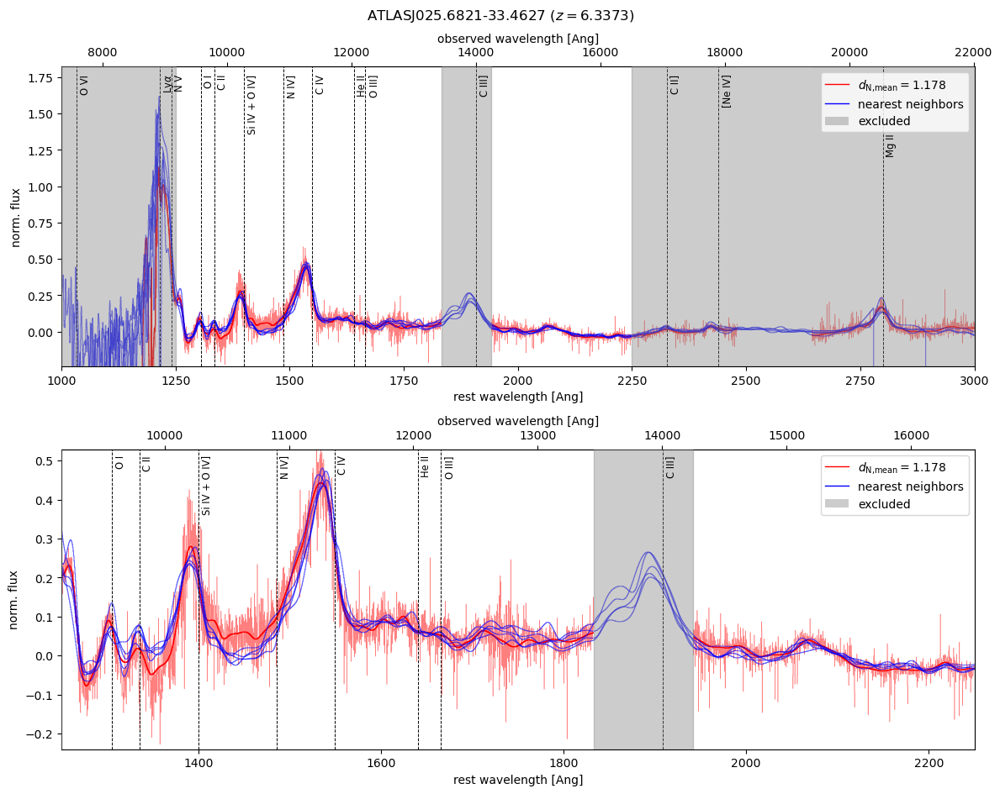

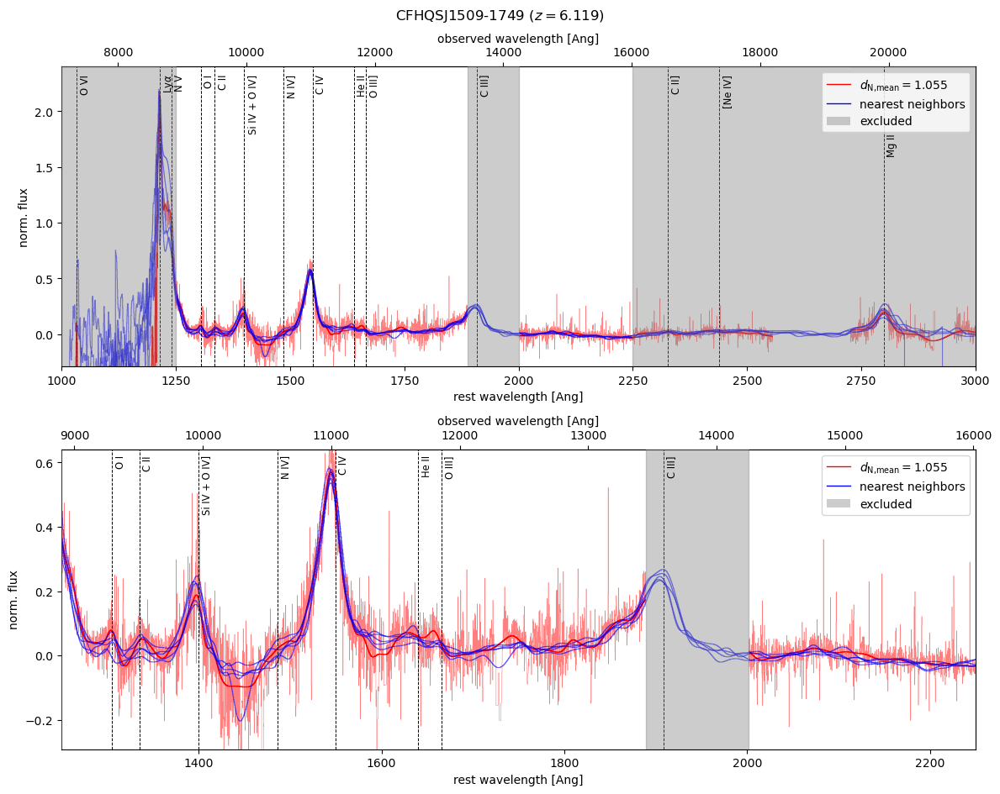

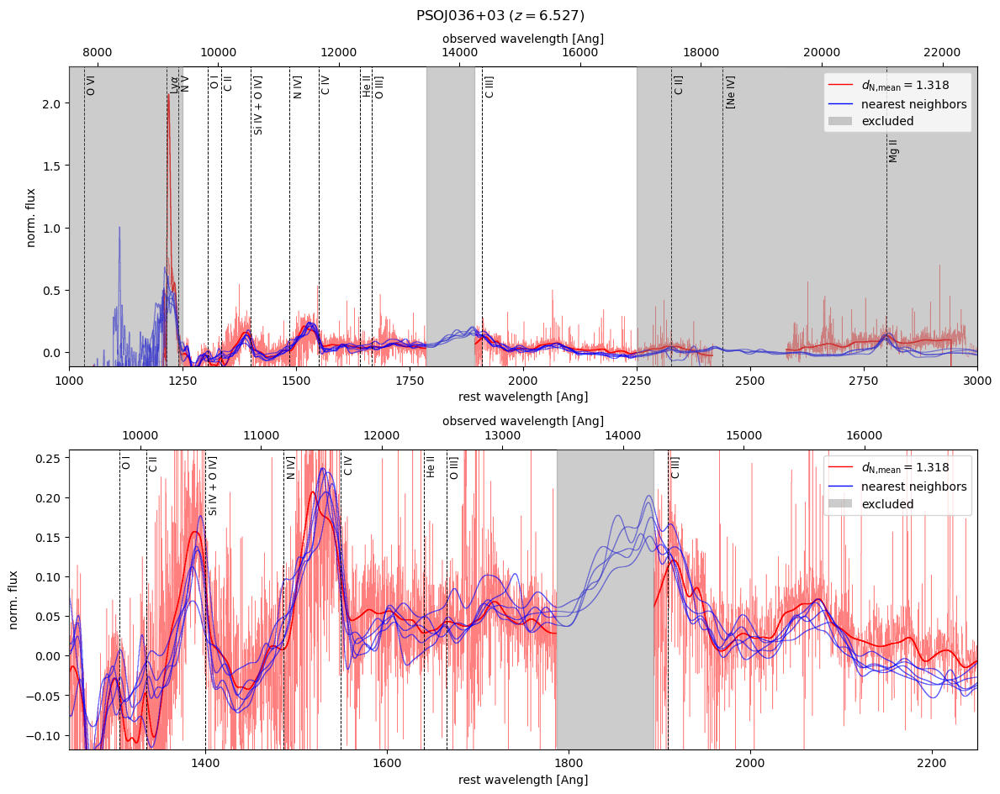

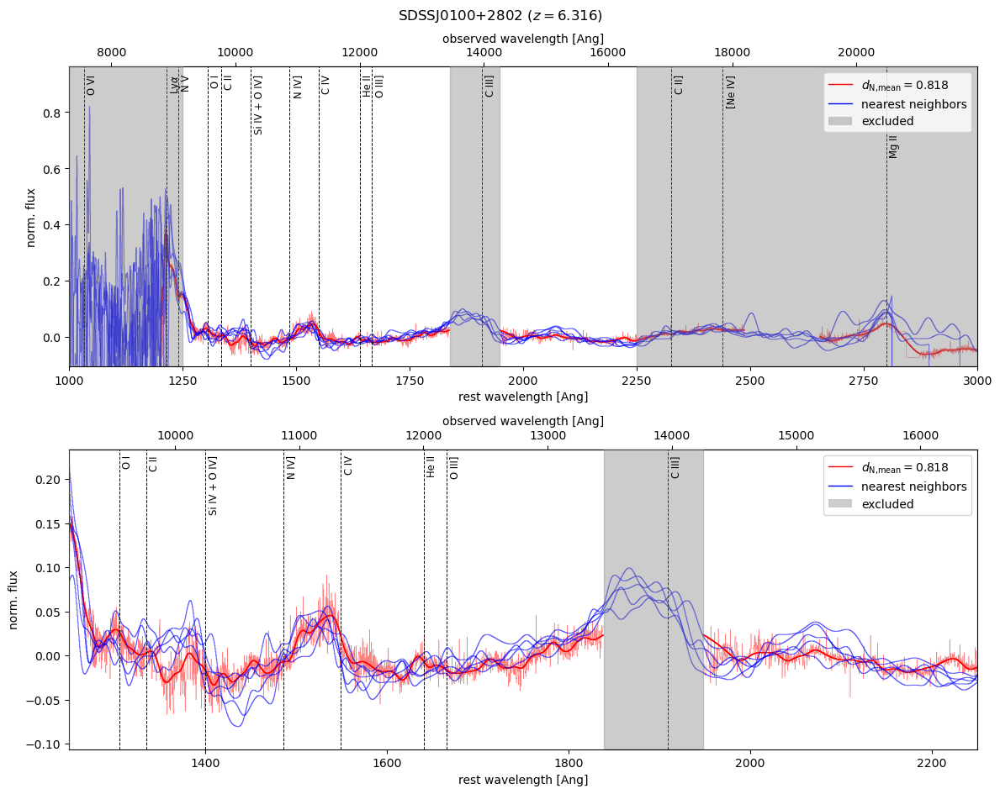

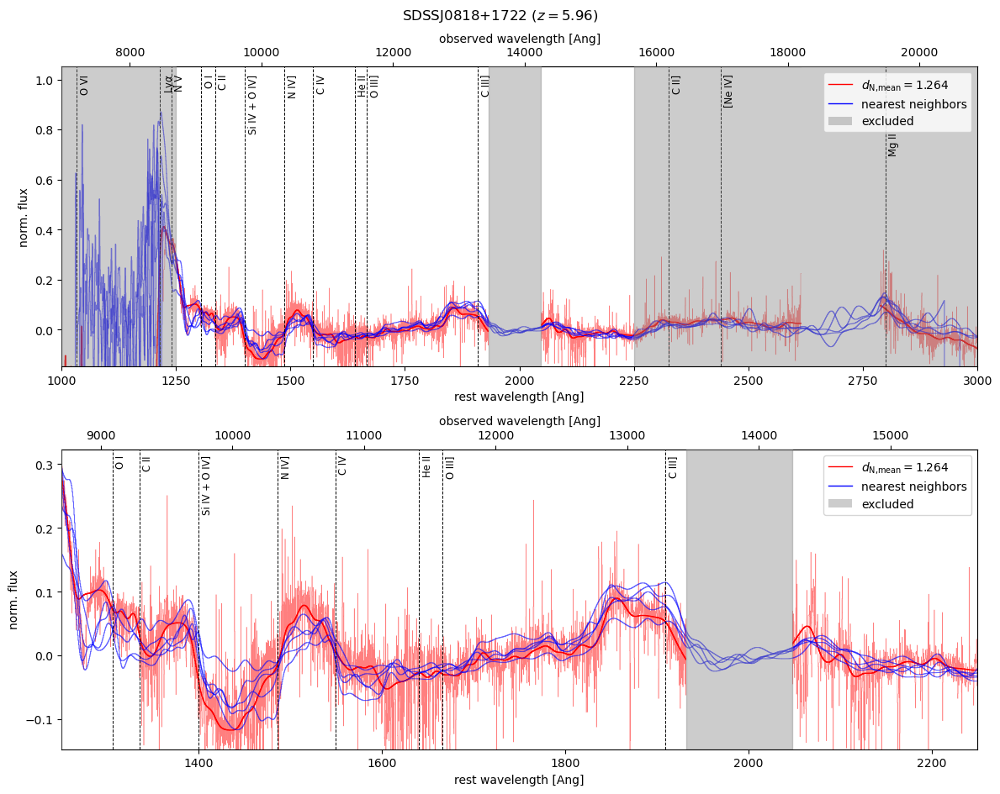

...

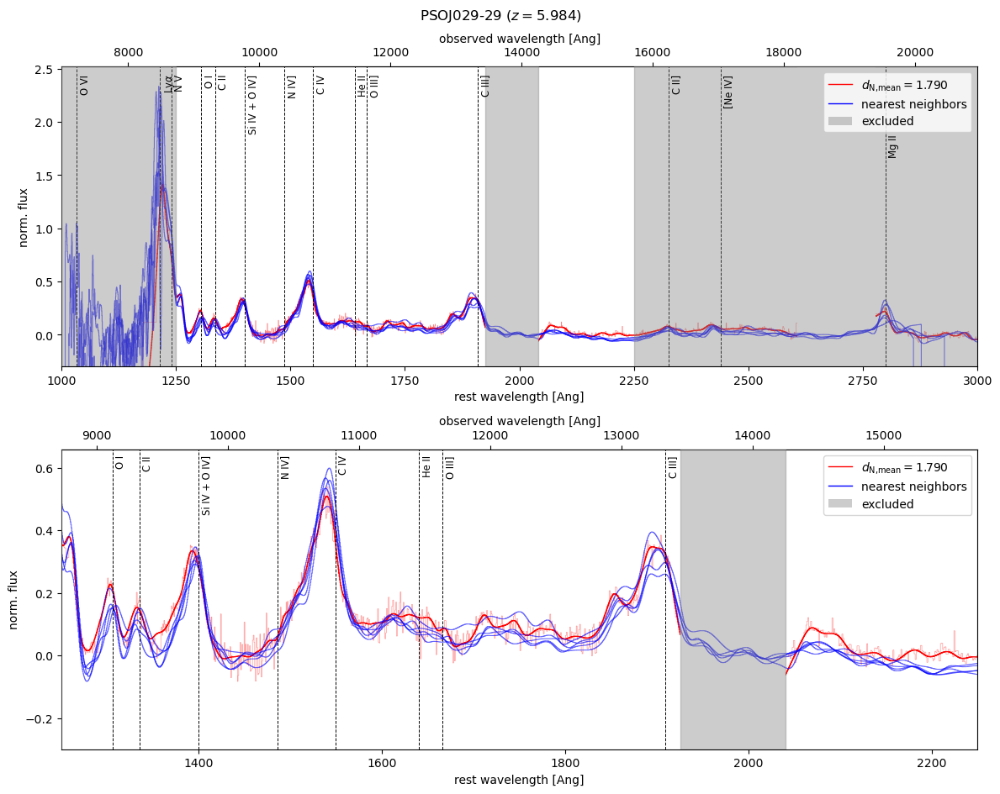

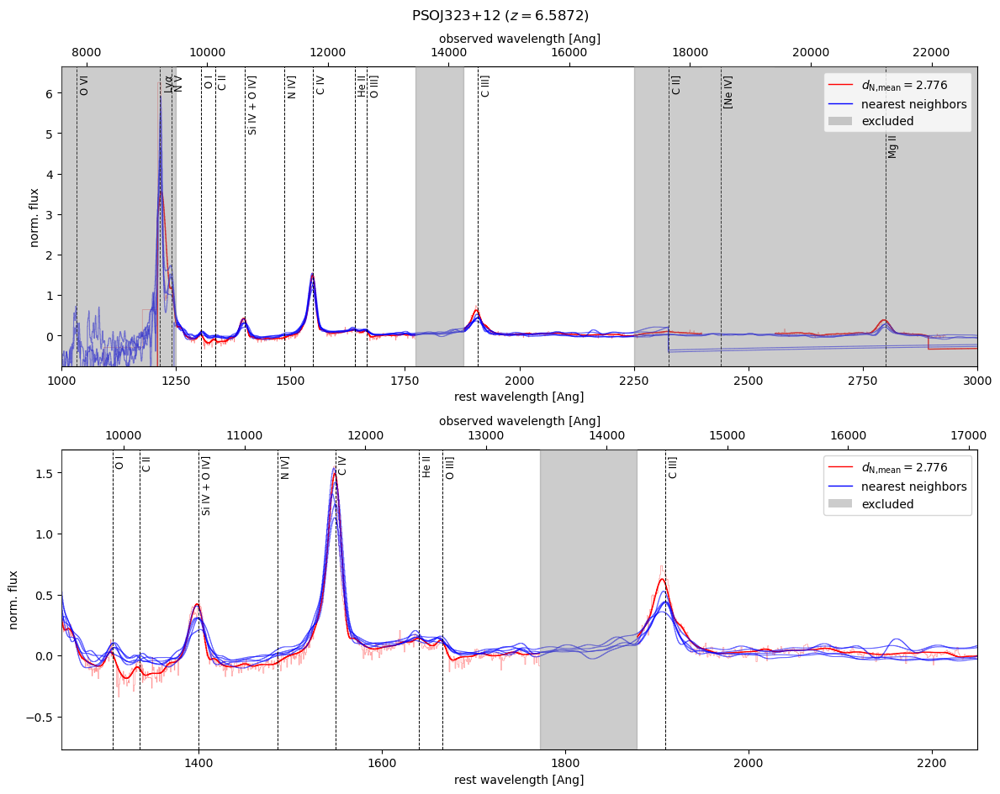

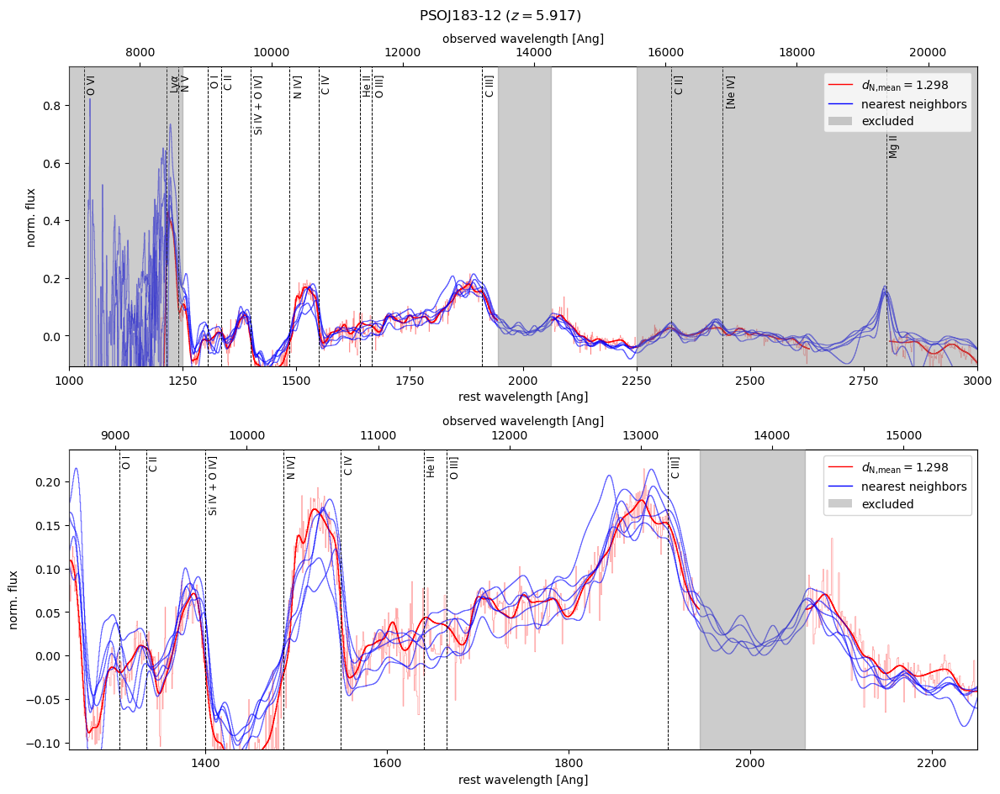

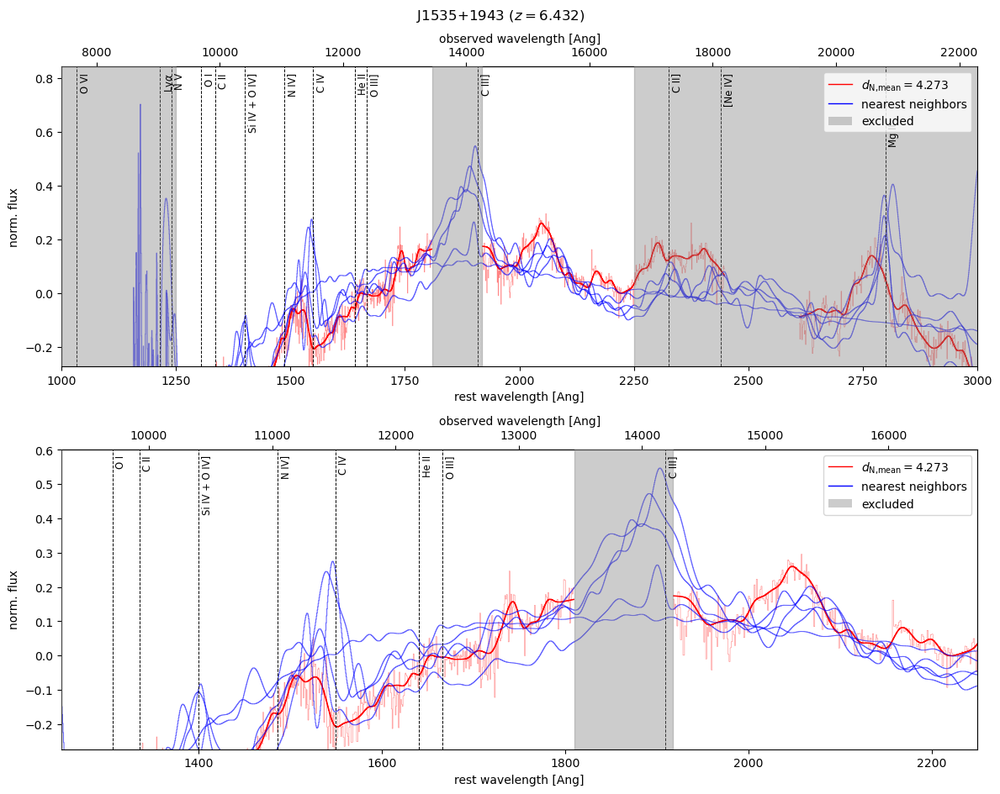

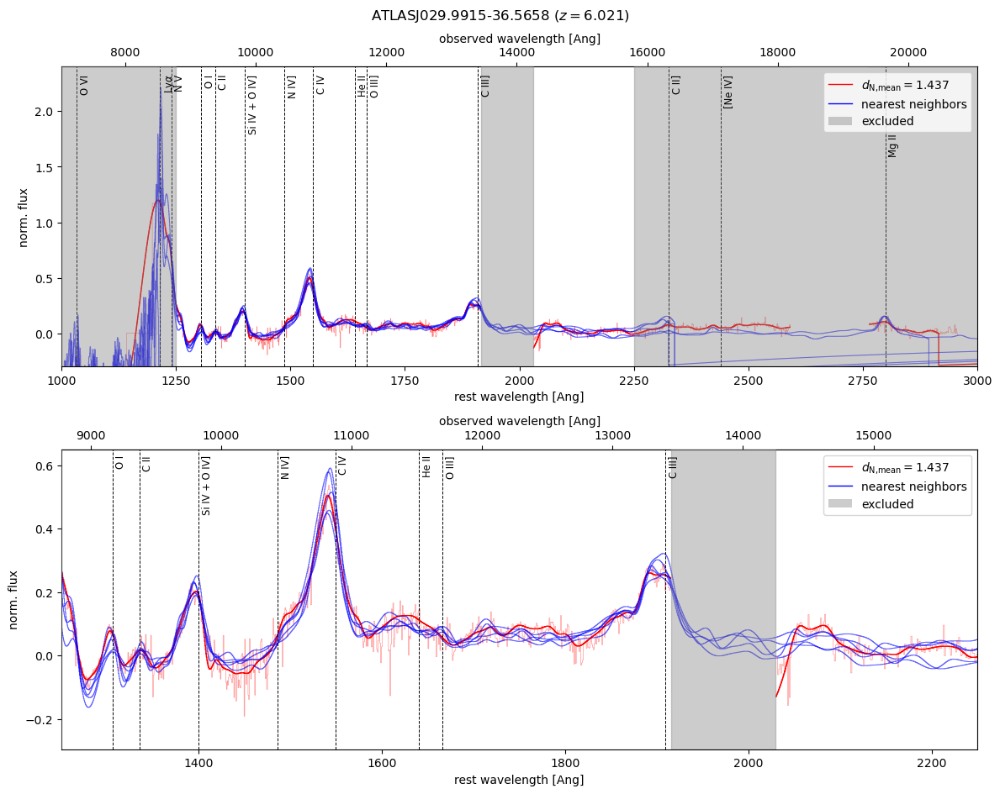

In [12]:
#pp = PdfPages('plots/highz_nn_large.pdf')
for i,qname in enumerate(qlist):
    # if qname != 'J2100-1715':
    #     continue
    z = float(hZ[i])

    idx_nn, d_nn = np.array([int(id) for id in IDX_NN[i]]), np.array([float(d) for d in D_NN[i]])
    dmean = np.mean(d_nn)

    ymax = []
    #fig, ax = plt.subplots(1)
    fig, axs = plt.subplots(2, 1)
    fig.set_figheight(9.6)
    fig.set_figwidth(12)
    fig.suptitle(qname + ' ($z={}$)'.format(z))
    for k,ax in enumerate(axs):
        try:
            plot_xdata(qname,fig,ax,'red',0.4,3)
        except Exception as error:            
            err = type(error).__name__
            print('{} not plotted:'.format(qname), err) 
            plt.close()
            continue
            
        ymax.append(plot_xfit(qname,z,fig,ax,'red',1))
    
        for j,nn in enumerate(idx_nn):
            ymax.append(plot_fit(nn,fig,ax,'b',0.8))
    
        ax.axvspan(w1l/(1+z), w1r/(1+z), alpha=0.4, color='grey',zorder=3)
        ax.axvspan(1000,1250,alpha=0.4,color='grey',zorder=3)
        ax.axvspan(2250,3000,alpha=0.4,color='grey',zorder=3)
        ylimit = max(ymax)
        ax.set_xlabel('rest wavelength [Ang]')
        ax.set_ylabel('norm. flux')
        sax = ax.secondary_xaxis('top', functions=(func(z),inv(z)))
        sax.set_xlabel('observed wavelength [Ang]')
        ax.legend(custom_lines, [r'$d_\text{{N,mean}}={:.3f}$'.format(dmean), 'nearest neighbors', 'excluded'], loc='upper right')  
    for j, l in enumerate(elines[:-1]):
        axs[0].axvline(l,c='black',ls='--',lw=0.7)
        axs[0].text(l+6,axs[0].get_ylim()[1]*0.973,enames[j],c='black',rotation='vertical',va='top',size='small')
    axs[0].axvline(elines[-1],c='black',ls='--',lw=0.7)
    axs[0].text(elines[-1]+6,axs[0].get_ylim()[1]*0.75,enames[-1],c='black',rotation='vertical',va='top',size='small')    
    for j, l in enumerate(elines[3:-3]):
        axs[1].axvline(l,c='black',ls='--',lw=0.7)
        axs[1].text(l+3,1.07*ylimit,enames[3:-3][j],c='black',rotation='vertical',va='top',size='small')
    axs[0].set_ylim(-0.5*ylimit,None)
    axs[1].set_ylim(-0.5*ylimit,1.1*ylimit)
    axs[0].set_xlim(1000,3000)
    axs[1].set_xlim(1250,2250)
    plt.tight_layout()
    #pp.savefig(fig)
    plt.savefig('plots/{}_nn.png'.format(qname),format='png')
    plt.show()
    plt.close()
#pp.close()

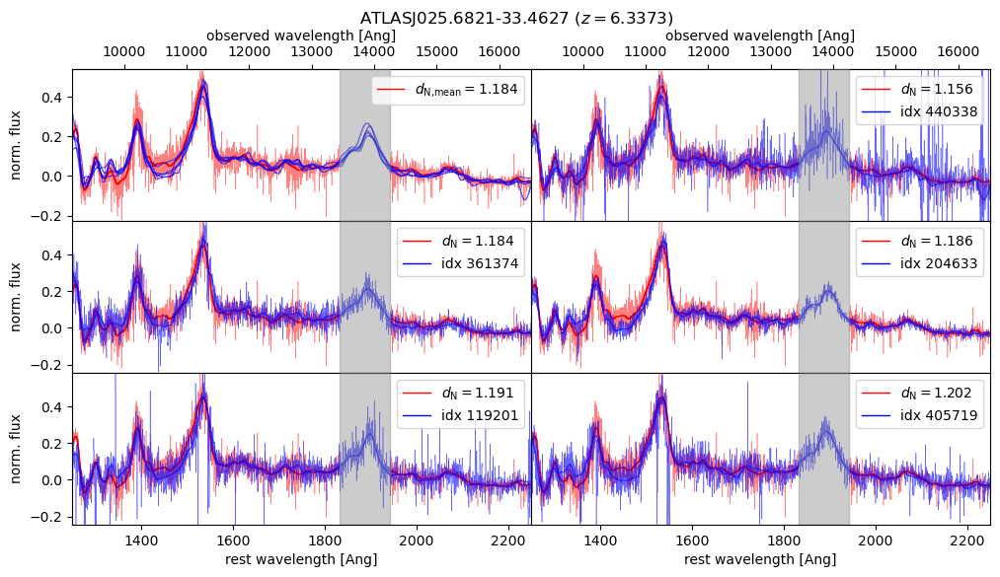

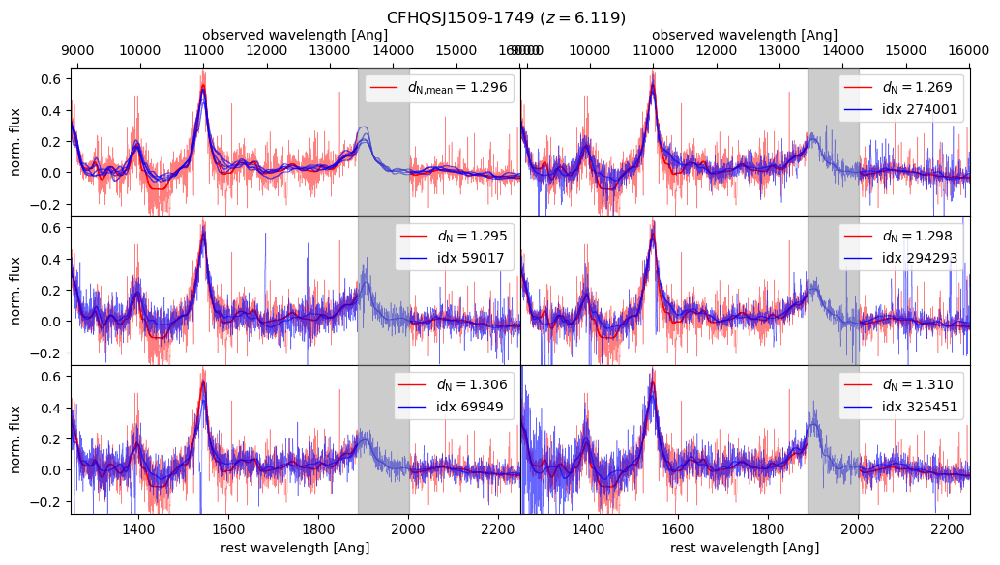

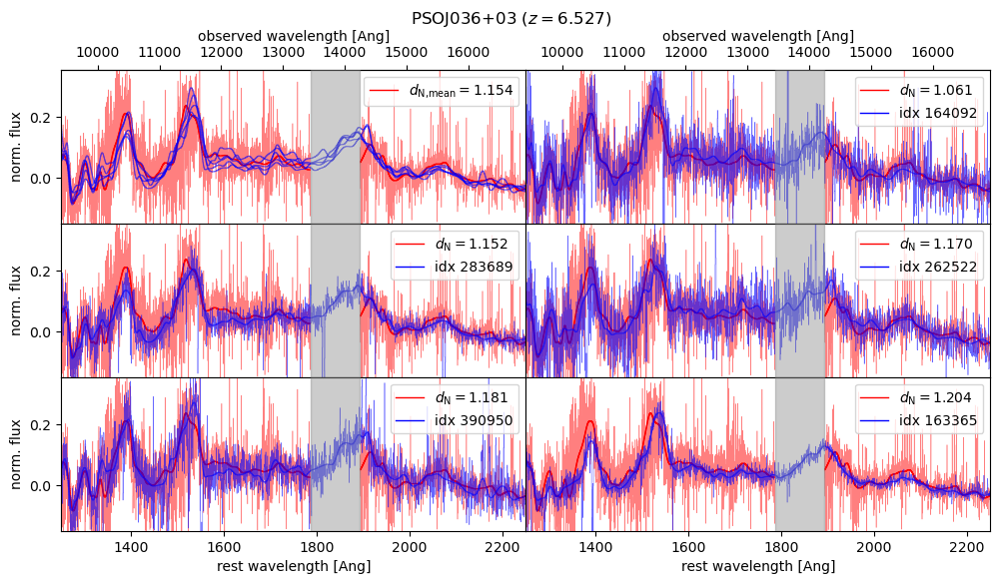

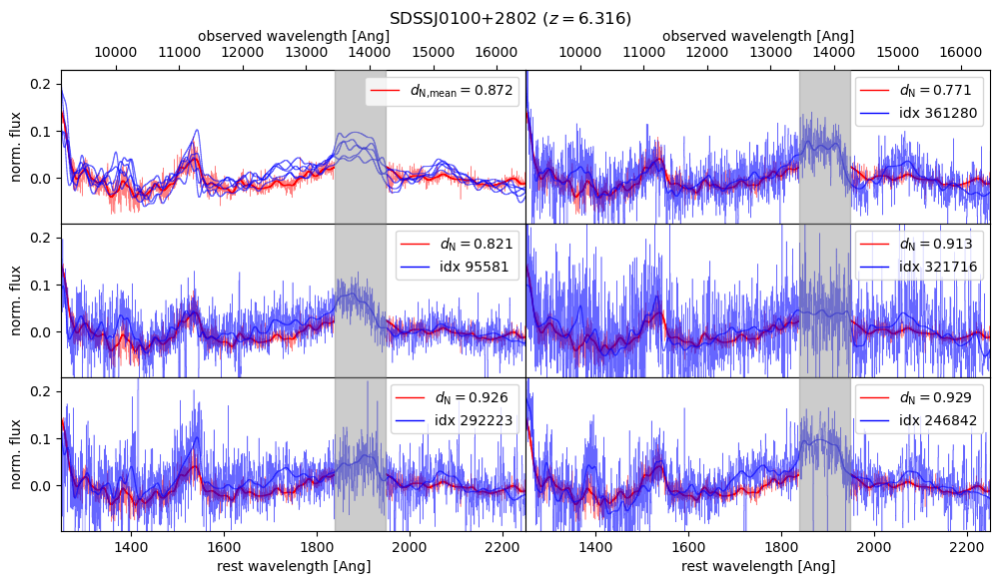

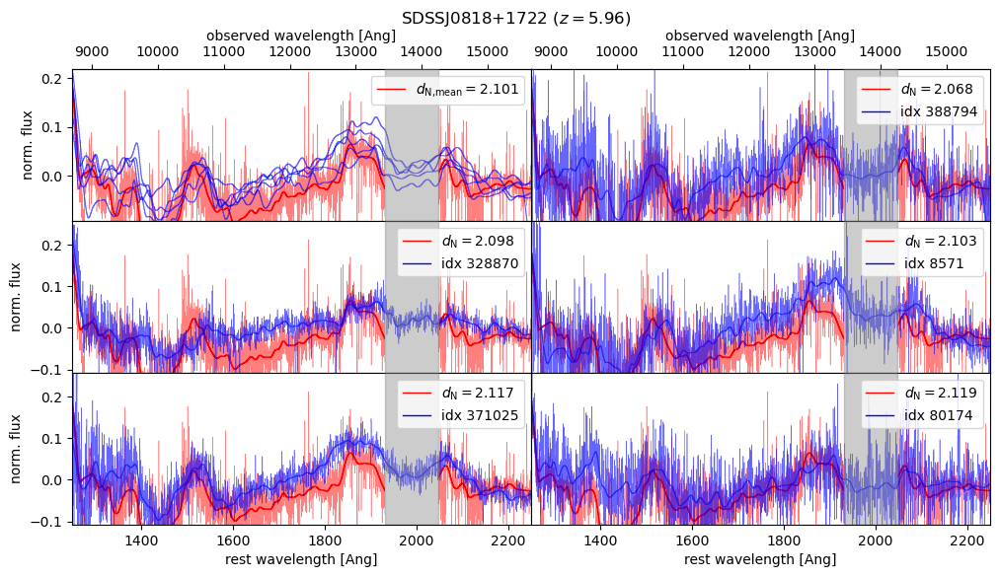

...

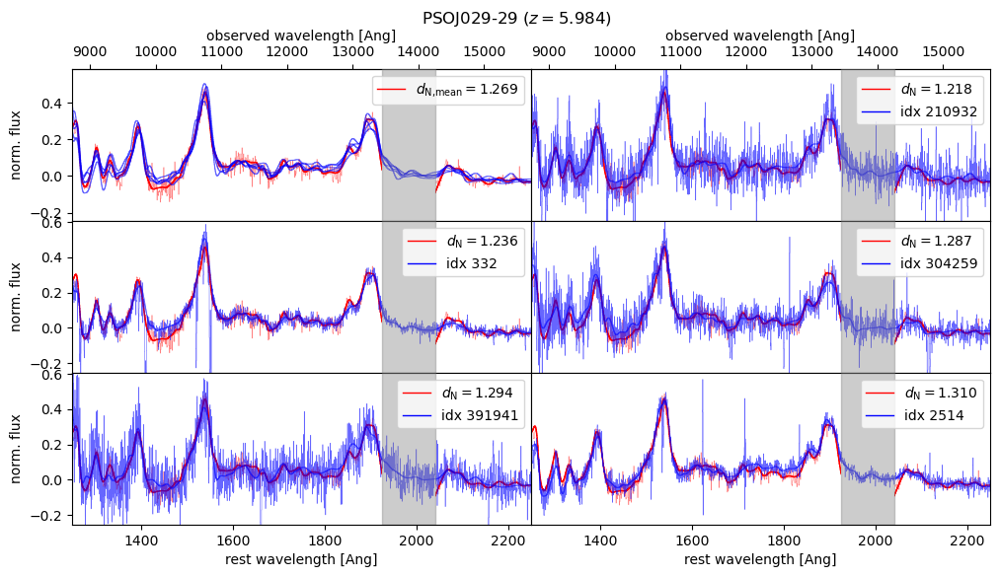

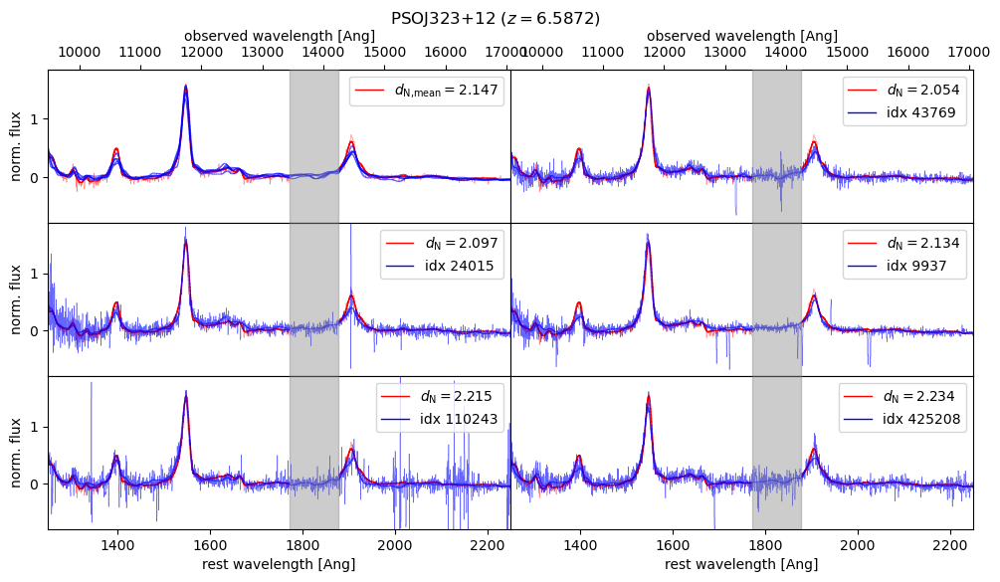

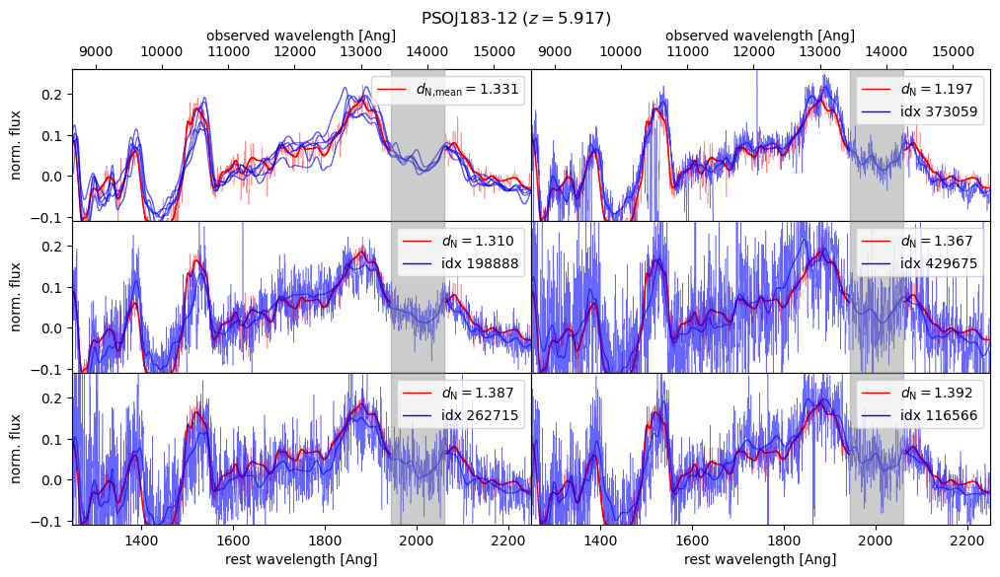

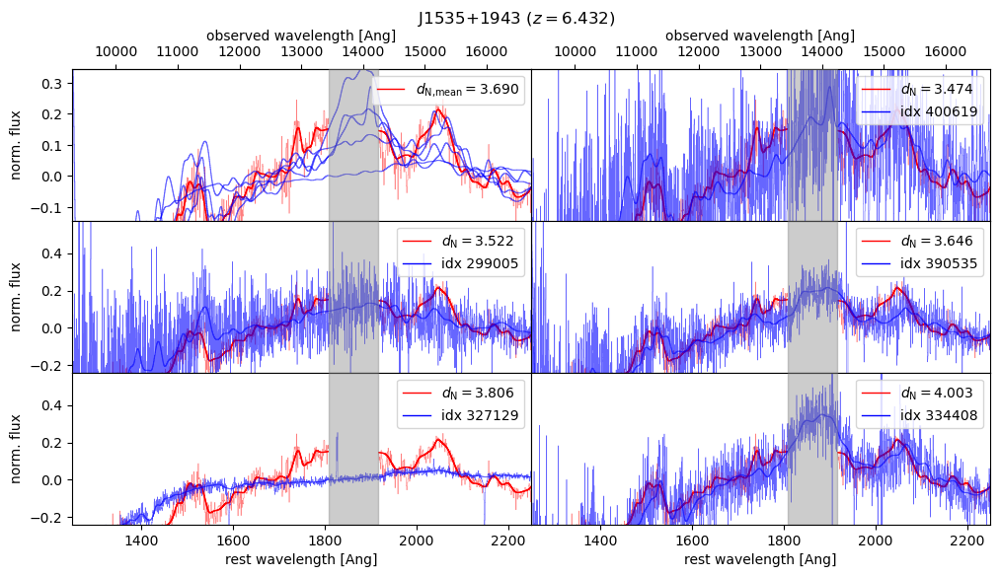

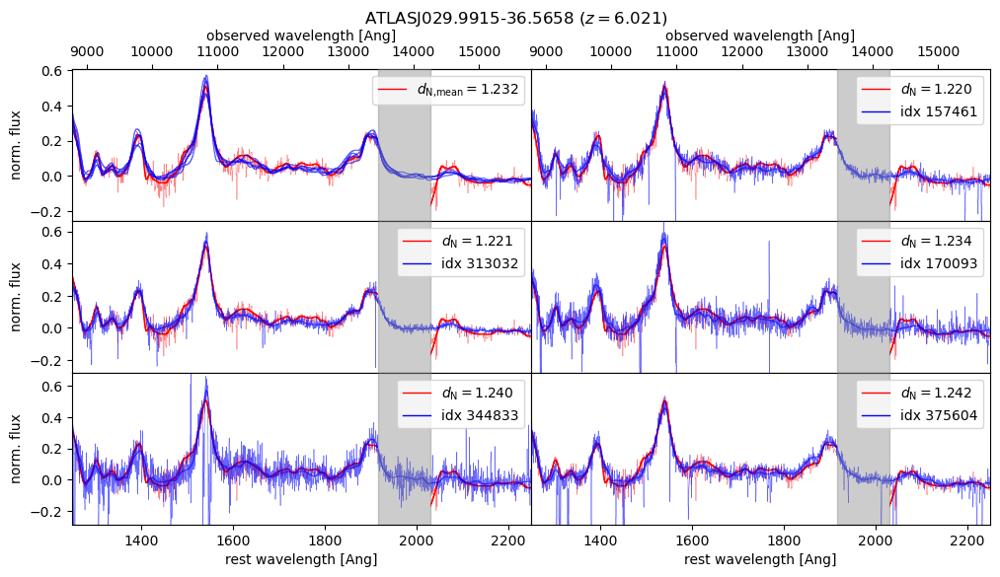

In [72]:
#pp = PdfPages('plots/highz_nn_compact.pdf')
for i,qname in enumerate(qlist):
    # if qname != 'PSOJ036+03':    #'PSOJ056-16': #
    #     continue
    z = float(hZ[i])

    idx_nn, d_nn = np.array([int(id) for id in IDX_NN[i]]), np.array([float(d) for d in D_NN[i]])
    dmean = np.mean(d_nn)

    ymax = []
    fig = plt.figure(2)
    fig.set_figwidth(12)
    fig.set_figheight(6)
    fig.suptitle(qname + ' ($z={}$)'.format(z))
    gs = gridspec.GridSpec(3, 2)

    # Create subplots within the gridspec
    ax1 = plt.subplot(gs[0])
    ax2 = plt.subplot(gs[1], sharex=ax1,sharey=ax1)
    ax3 = plt.subplot(gs[2], sharex=ax1)
    ax4 = plt.subplot(gs[3], sharex=ax1,sharey=ax3)
    ax5 = plt.subplot(gs[4], sharex=ax1)
    ax6 = plt.subplot(gs[5], sharex=ax1,sharey=ax5)
    ax = [ax1,ax2,ax3,ax4,ax5,ax6]

    # Plot data on each subplot
    try:
        plot_xdata(qname,fig,ax1,'red',0.4,3)
    except Exception as error:            
        err = type(error).__name__
        print('{} not plotted:'.format(qname), err) 
        plt.close()
        continue
        
    ymax.append(plot_xfit(qname,z,fig,ax1,'red',1))
    for j,nn in enumerate(idx_nn):
        ymax.append(plot_fit(nn,fig,ax1,'b',0.8))

        plot_xdata(qname,fig,ax[j+1],'red',0.4,3)
        plot_xfit(qname,z,fig,ax[j+1],'red',1)
        plot_norm(nn,fig,ax[j+1],'b',0.4)
        plot_fit(nn,fig,ax[j+1],'b',0.8)

        ylimit = max(ymax)
        #ylimit=1.5
        ax[j+1].axvspan(w1l/(1+z), w1r/(1+z), alpha=0.4, color='grey',zorder=3)
        ax[j+1].set_ylim(-0.5*ylimit,1.2*ylimit)
        ax[j+1].set_xlim(1250,2250)

        ax[j+1].legend(custom_lines, [r'$d_\text{{N}}={:.3f}$'.format(d_nn[j]), 'idx {}'.format(idx_nn[j])], loc='upper right')

    ax1.axvspan(w1l/(1+z), w1r/(1+z), alpha=0.4, color='grey',zorder=3)
    ax1.legend([Line2D([0], [0], color='r', lw=1)], [r'$d_\text{{N,mean}}={:.3f}$'.format(dmean)], loc='upper right')
    
    sax1 = ax1.secondary_xaxis('top', functions=(func(z),inv(z)))
    sax1.set_xlabel('observed wavelength [Ang]')    
    sax2 = ax2.secondary_xaxis('top', functions=(func(z),inv(z)))
    sax2.set_xlabel('observed wavelength [Ang]')

    ax1.set_ylabel('norm. flux')
    ax3.set_ylabel('norm. flux')
    ax5.set_ylabel('norm. flux')
    ax5.set_xlabel('rest wavelength [Ang]')
    ax6.set_xlabel('rest wavelength [Ang]')
    
    ax2.tick_params(axis='y', which='both', left=False, labelleft=False)
    ax4.tick_params(axis='y', which='both', left=False, labelleft=False)
    ax6.tick_params(axis='y', which='both', left=False, labelleft=False)

    # Remove the space between subplots
    plt.subplots_adjust(hspace=0)
    plt.subplots_adjust(wspace=0)
    plt.savefig('plots/{}_compact.png'.format(qname),format='png')
    #pp.savefig(fig)

    #plt.tight_layout()
    plt.show()
    plt.close()
    
#pp.close()

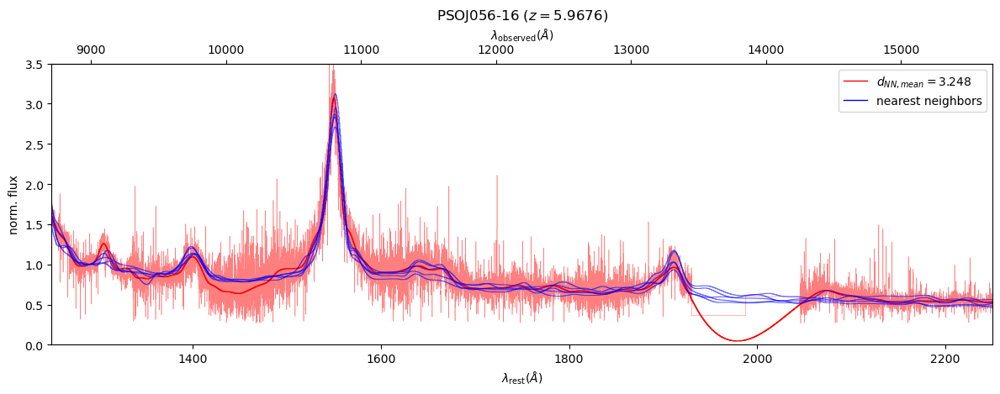

In [17]:
from matplotlib.lines import Line2D

custom_lines = [Line2D([0], [0], color='r', lw=1),
                Line2D([0], [0], color='b', lw=1)]


z =  5.9676 #6.02 #6.1456
dmean = np.mean([3.194506121300424 ,3.2269624590764656,	3.233967506391231,	3.2655120258028014,	3.3192018971480675])  #np.mean([1.0215876088820603,1.0804486366085282,	1.1282840364908024,	1.141484546620482,	1.1703469722300683 ]) #np.mean([3.5218537822631513 ,3.558982469636067 ,3.601671546987285,	3.6789086735744703 ,3.725048900039639])
qname = 'PSOJ056-16'#'SDSSJ1306+0356' #'VIKJ2318-3029'  
nn1,nn2,nn3,nn4,nn5 =118340 ,342807 ,105486 ,110948 ,60581 #347622,383988,69148,113000,437077 #298518 ,348452 ,361298 ,125350 ,154666  #
fig,ax = plt.subplots()
fig.set_figwidth(12)
plot_xdata(qname,fig,ax,'red',0.4)
plot_xfit(qname,fig,ax,'red',1)
#plot_norm(222565,fig,ax,'blue')
plot_fit(nn1,fig,ax,'b',0.8)
plot_fit(nn2,fig,ax,'b',0.8)
plot_fit(nn3,fig,ax,'b',0.8)
plot_fit(nn4,fig,ax,'b',0.8)
plot_fit(nn5,fig,ax,'b',0.8)
ax.set_ylim(0,3.5)
ax.set_xlim(1250,2250)
ax.set_xlabel('$\lambda_\mathrm{rest} (\AA)$')
ax.set_ylabel('norm. flux')
sax = ax.secondary_xaxis('top', functions=(func(z),inv(z)))
sax.set_xlabel('$\lambda_\mathrm{observed} (\AA)$')
ax.legend(custom_lines, ['$d_{{NN,mean}}={:.3f}$'.format(dmean), 'nearest neighbors'])
plt.title(qname + ' ($z={}$)'.format(z))
plt.tight_layout()
plt.savefig('plots/eg_{}.pdf'.format(qname), format='pdf')
plt.show()
plt.close()

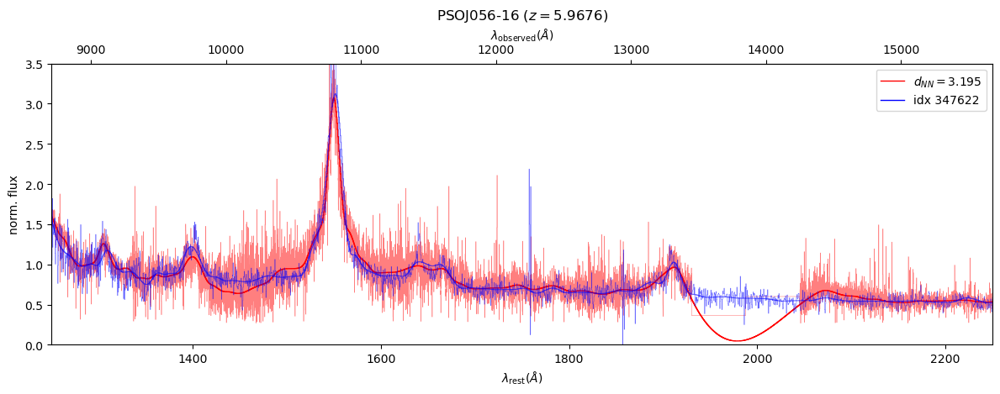

In [15]:
fig,ax = plt.subplots()
fig.set_figwidth(12)
plot_xdata(qname,fig,ax,'red',0.4)
plot_xfit(qname,fig,ax,'red',1)
plot_norm(nn1,fig,ax,'blue')
plot_fit(nn1,fig,ax,'b',0.8)
# plot_fit(383988,fig,ax,'b',0.8)
# plot_fit(69148,fig,ax,'b',0.8)
# plot_fit(113000,fig,ax,'b',0.8)
# plot_fit(437077,fig,ax,'b',0.8)
ax.set_ylim(0,3.5)
ax.set_xlim(1250,2250)
ax.set_xlabel('$\lambda_\mathrm{rest} (\AA)$')
ax.set_ylabel('norm. flux')
sax = ax.secondary_xaxis('top', functions=(func(z),inv(z)))
sax.set_xlabel('$\lambda_\mathrm{observed} (\AA)$')
ax.legend(custom_lines, ['$d_{{NN}}={:.3f}$'.format(3.194506121300424), 'idx 347622'],loc='upper right')   #1.0215876088820603  #3.5218537822631513
plt.title(qname + ' ($z={}$)'.format(z))
plt.tight_layout()
plt.savefig('plots/eg_{}_NN.pdf'.format(qname), format='pdf')
plt.show()
plt.close()

In [ ]:
dpath= '/media/bartosz/Volume/BOSS_DR14/data/'
dnn = np.loadtxt(dpath + 'nearest_neighbors_nonBALs_2.txt')
didx = dnn[:,0]
dnn_idx = dnn[:,2:7]
dnn_d = dnn[:,8:13]
dd_mean = np.array([np.mean(d) for d in dnn_d])


dpath = '/media/bartosz/Volume/XQR30/data/'
fpath = dpath + 'fits/'
npath = dpath + 'normed/'

nnfile = np.loadtxt(dpath + 'highZ_NN_trim.txt',dtype='str')
qnames = nnfile[:,0]
nn_IDs = nnfile[:,1:6]
nn_Ds = nnfile[:,6:]

nnfile_prev = np.loadtxt(dpath + 'highZ_NN.txt',dtype='str')
nn_Ds_prev = nnfile_prev[:,6:]

Xmeta = np.loadtxt(dpath + 'meta.txt',dtype='str')
Xqnames = Xmeta[:,0]
Z = Xmeta[:,1]
wl1r = [float(wl) for wl in Xmeta[:,2]]
wl2r = [float(wl) for wl in Xmeta[:,3]]

def func(z):
    def func2(x):
        return x*(1+z)
    return func2

def inv(z):
    def inv2(x):
        return x/(1+z)
    return inv2

props = dict(boxstyle='square', facecolor='white', alpha=0.2)
for i,q in enumerate(qnames):    
    qso_idx = np.nonzero(Xqnames == q)[0][0]
    z = float(Z[qso_idx])

    d_mean = np.mean([float(j) for j in nn_Ds[i]])
    d_mean_prev = np.mean([float(j) for j in nn_Ds_prev[i]])
    
    pp = PdfPages('plots/{}_NN.pdf'.format(q))
    fig = plt.figure(0)
    ax = fig.subplots()
    fig.set_figwidth(15)
    plot_xdata(q,fig,ax,'grey',1)
    Ymax = []
    for idx in nn_IDs[i]:
        ymax = plot_fit(int(idx),fig,ax,'red',1)
        Ymax.append(ymax)
    ymax = plot_xfit(q,fig,ax,'black',1)
    Ymax.append(ymax)
    ax.set_ylim(-0.1,1.1*max(Ymax))
    ax.set_xlim(1250,2250)
    ax.set_xlabel('$\lambda_\mathrm{rest} (\AA)$')
    ax.set_ylabel('flux')
    ax.axvspan(wl1r[i], wl2r[i], alpha=0.3, color='red')
    custom = [Line2D([0], [0], color='grey', lw=1),
                Line2D([0], [0], color='black', lw=1),
                Line2D([0], [0], color='red', lw=1)]
    ax.legend(custom, ['observed flux', 'spline fit', 'low-z NN'], loc=1)
    info = '\n'.join((r'{}'.format(q),
                      r'$z={}$'.format(z),
                      r'$d_\mathrm{{NN,mean}}^\mathrm{{trim}}={:.3f}$'.format(d_mean),
                      r'$d_\mathrm{{NN,mean}}^\mathrm{{prev}}={:.3f}$'.format(d_mean_prev)))

    ax.text(0.5, 0.97, info, transform=ax.transAxes, fontsize=10,
                verticalalignment='top', horizontalalignment='center', bbox=props)
    ax2 = ax.secondary_xaxis('top', functions=(func(z),inv(z)))
    ax2.set_xlabel('$\lambda_\mathrm{observed} (\AA)$')

    plt.show()
    pp.savefig(fig)
    plt.close()
    
    for j,idx in enumerate(nn_IDs[i]):
        sf=plt.figure(1)
        sax=sf.subplots()
        sf.set_figwidth(15)
        plot_xdata(q,sf,sax,'grey',1)
        plot_xfit(q,sf,sax,'black',1)
        plot_data(idx,sf,sax,'blue',1)
        plot_fit(idx,sf,sax,'red',1)
        sax.set_ylim(-0.1,1.1*max(Ymax)) 
        sax.set_xlim(1250,2250)
        sax.axvspan(wl1r[i], wl2r[i], alpha=0.3, color='red')
        sax.set_xlabel('$\lambda_{rest} (\AA)$')
        sax.set_ylabel('flux')

        scustom = [Line2D([0], [0], color='grey', lw=1),
                    Line2D([0], [0], color='black', lw=1),
                    Line2D([0], [0], color='blue', lw=1),
                    Line2D([0], [0], color='red', lw=1)]
        sax.legend(scustom, ['observed flux', 'spline fit', 'NN observed flux', 'NN spline fit'], loc=1)
        sinfo = '\n'.join((r'{}'.format(q),
                           r'$z={:.3f}$'.format(z),
                           r'$d_\mathrm{{NN}}={:.3f}$'.format(float(nn_Ds[i][j]))))
        sax.text(0.5, 0.97, sinfo, transform=sax.transAxes, fontsize=10,
                    verticalalignment='top', horizontalalignment='center', bbox=props)
        z_low = get_z(meta,int(idx))
        sinfo2 = '\n'.join((r'idx: {}'.format(int(idx)),
                            r'$z={:.3f}$'.format(z_low)))
        sax.text(0.7, 0.97, sinfo2, transform=sax.transAxes, fontsize=10,
                     verticalalignment='top', horizontalalignment='center', bbox=props)
        sax2 = sax.secondary_xaxis('top', functions=(func(z),inv(z)))
        sax2.set_xlabel('$\lambda_\mathrm{observed} (\AA)$')
        pp.savefig(sf)       
        plt.close()

    nn = np.loadtxt(dpath + 'eBOSS_NN_trim/{}_NN.txt'.format(q))
    
    idx = nn[:,0]
    
    nn_idx = nn[:,2:7]
    nn_d = nn[:,8:13]
    
    d_mean_eBOSS = np.array([np.mean(d) for d in nn_d])

    bins = np.linspace(0.5, 6.5, 50)
    fig, ax = plt.subplots()

    plt.hist(dd_mean,bins,density=True,alpha=0.5,label=r'$\lambda^\mathrm{{prev}}=2250\mathrm{{\AA}}$',color='tab:orange')
    plt.hist(d_mean_eBOSS,bins, density = True,alpha=0.8,label=r'$\lambda_{{13450}}={:.0f}\mathrm{{\AA}}$'.format(wl1r[i]),color='tab:green')
    plt.axvline(d_mean_prev,color='tab:orange',label='$d_\mathrm{{mean,NN}}^\mathrm{{prev}}={:.3f}$'.format(d_mean_prev))
    plt.axvline(d_mean,color='tab:green',label='$d_\mathrm{{mean,NN}}^\mathrm{{trim}}={:.3f}$'.format(d_mean))
    plt.xlim(0.4,6.5)
    plt.legend()
    plt.xlabel('NN mean distance')
    plt.ylabel('norm. counts')
    plt.title('eBOSS NNs for {}'.format(q))
    
    plt.grid(axis='y', alpha=0.75)
    pp.savefig(fig)
    plt.close()

    pp.close()